In [1]:
import pdb
import cv2
import pandas as pd
import numpy as np
from PIL import Image
from pathlib import Path
from matplotlib import pyplot as plt
from mpl_toolkits.mplot3d import axes3d, Axes3D

# Load the SDK
from lyft_dataset_sdk.lyftdataset import LyftDataset, LyftDatasetExplorer, Quaternion, view_points
from lyft_dataset_sdk.utils.data_classes import LidarPointCloud

from tqdm import tqdm_notebook as tqdm

%matplotlib inline

In [2]:
lyftdata = LyftDataset(data_path='../3d-object-detection-for-autonomous-vehicles/', json_path='../3d-object-detection-for-autonomous-vehicles/train_data', verbose=True)

9 category,
18 attribute,
4 visibility,
18421 instance,
10 sensor,
148 calibrated_sensor,
177789 ego_pose,
180 log,
180 scene,
22680 sample,
189504 sample_data,
638179 sample_annotation,
1 map,
Done loading in 10.9 seconds.
Reverse indexing ...
Done reverse indexing in 2.2 seconds.


In [4]:
DATA_PATH = '../3d-object-detection-for-autonomous-vehicles/'
train = pd.read_csv(DATA_PATH + 'train.csv')
sample_submission = pd.read_csv(DATA_PATH + 'sample_submission.csv')
# Taken from https://www.kaggle.com/gaborfodor/eda-3d-object-detection-challenge

object_columns = ['sample_id', 'object_id', 'center_x', 'center_y', 'center_z',
                  'width', 'length', 'height', 'yaw', 'class_name']
objects = []
for sample_id, ps in tqdm(train.values[:]):
    object_params = ps.split()
    n_objects = len(object_params)
    for i in range(n_objects // 8):
        x, y, z, w, l, h, yaw, c = tuple(object_params[i * 8: (i + 1) * 8])
        objects.append([sample_id, i, x, y, z, w, l, h, yaw, c])
train_objects = pd.DataFrame(
    objects,
    columns = object_columns
)

In [6]:
numerical_cols = ['object_id', 'center_x', 'center_y', 'center_z', 'width', 'length', 'height', 'yaw']
train_objects[numerical_cols] = np.float32(train_objects[numerical_cols].values)
train_objects.head()

,sample_id,object_id,center_x,center_y,center_z,width,length,height,yaw,class_name
0,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,0.0,2680.282959,698.196899,-18.047768,2.064,5.488,2.053,2.604164,car
1,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,1.0,2691.997559,660.801636,-18.674259,1.818,4.570,1.608,-0.335176,car
2,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,2.0,2713.607422,694.403503,-18.589972,1.779,4.992,1.620,2.579456,car
3,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,3.0,2679.986816,706.910156,-18.349594,1.798,3.903,1.722,2.586166,car
4,db8b47bd4ebdf3b3fb21598bb41bd8853d12f8d2ef25ce...,4.0,2659.352051,719.417480,-18.442999,1.936,4.427,1.921,2.601799,car


Visualizing a lidar sample with the SDK's built in function:

In [9]:
train = pd.read_csv('../3d-object-detection-for-autonomous-vehicles/train.csv')
sampletoken = train.iloc[10]["Id"]
my_sample = lyftdata.get('sample', sampletoken)
lyftdata.render_sample_3d_interactive(my_sample['token'], render_sample=False)

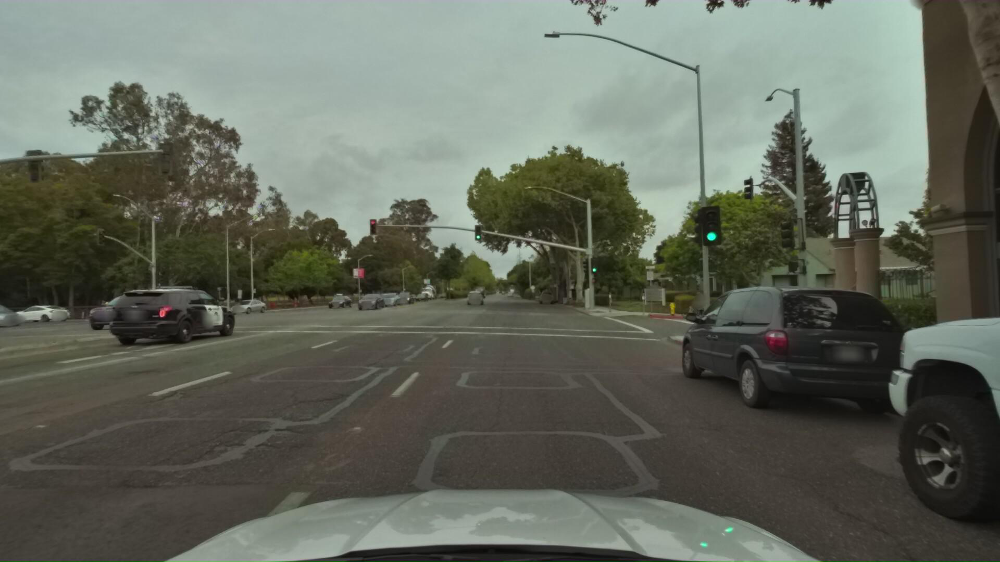

In [13]:
sensor = 'CAM_FRONT'
cam_front = lyftdata.get('sample_data', my_sample['data'][sensor])
img = Image.open('../3d-object-detection-for-autonomous-vehicles/train_'+cam_front['filename'])
img

In [17]:
lidar_top = lyftdata.get('sample_data', my_sample['data']['LIDAR_TOP'])
pc = LidarPointCloud.from_file(Path('../3d-object-detection-for-autonomous-vehicles/'+lidar_top['filename']))

In [18]:
axes_limits = [
    [-30, 50], # X axis range
    [-30, 20], # Y axis range
    [-3, 10]   # Z axis range
]
axes_str = ['X', 'Y', 'Z']

def display_frame_statistics(lidar_points, points=0.2):
    """
    Displays statistics for a single frame. Draws 3D plot of the lidar point cloud data and point cloud
    projections to various planes.
    
    Parameters
    ----------
    lidar_points: lidar data points 
    points          : Fraction of lidar points to use. Defaults to `0.2`, e.g. 20%.
    """
    
    points_step = int(1. / points)
    point_size = 0.01 * (1. / points)
    pc_range = range(0, lidar_points.shape[1], points_step)
    pc_frame = lidar_points[:, pc_range]
    def draw_point_cloud(ax, title, axes=[0, 1, 2]):
        """Convenient method for drawing various point cloud projections as a part of frame statistics"""
        ax.set_facecolor('black')
        ax.grid(False)
        ax.scatter(*pc_frame[axes, :], s=point_size, c='white', cmap='grey')
        if len(axes) == 3: # 3D configs
            text_color = 'white'
            ax.set_xlim3d([-10, 30])
            ax.set_ylim3d(*axes_limits[axes[1]])
            ax.set_zlim3d(*axes_limits[axes[2]])
            ax.set_zlabel('{} axis'.format(axes_str[axes[2]]), color='white')
        else: # 2D configs
            text_color = 'black' # the `figure` is white
            ax.set_xlim(*axes_limits[axes[0]])
            ax.set_ylim(*axes_limits[axes[1]])
        ax.set_title(title, color=text_color)
        ax.set_xlabel('{} axis'.format(axes_str[axes[0]]), color=text_color)
        ax.set_ylabel('{} axis'.format(axes_str[axes[1]]), color=text_color)
            
    # Draw point cloud data as 3D plot
    f2 = plt.figure(figsize=(15, 8))
    ax2 = f2.add_subplot(111, projection='3d')
    # make the panes transparent
    ax2.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    ax2.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
    draw_point_cloud(ax2, '3D plot')
    
    plt.show()
    plt.close(f2)
    # Draw point cloud data as plane projections
    f, ax3 = plt.subplots(3, 1, figsize=(15, 25))
#     f.set_facecolor('black')
    draw_point_cloud(
        ax3[0], 
        'XZ projection (Y = 0)', #, the car is moving in direction left to right', ?
        axes=[0, 2] # X and Z axes
    )
    draw_point_cloud(
        ax3[1], 
        'XY projection (Z = 0)', #, the car is moving in direction left to right',? 
        axes=[0, 1] # X and Y axes
    )
    draw_point_cloud(
        ax3[2], 
        'YZ projection (X = 0)', #, the car is moving towards the graph plane', ?
        axes=[1, 2] # Y and Z axes
    )
    plt.show()
    plt.close(f)

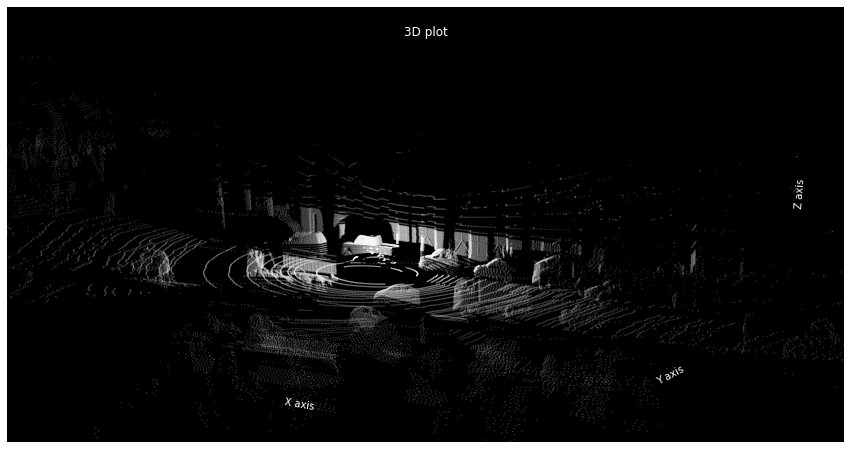

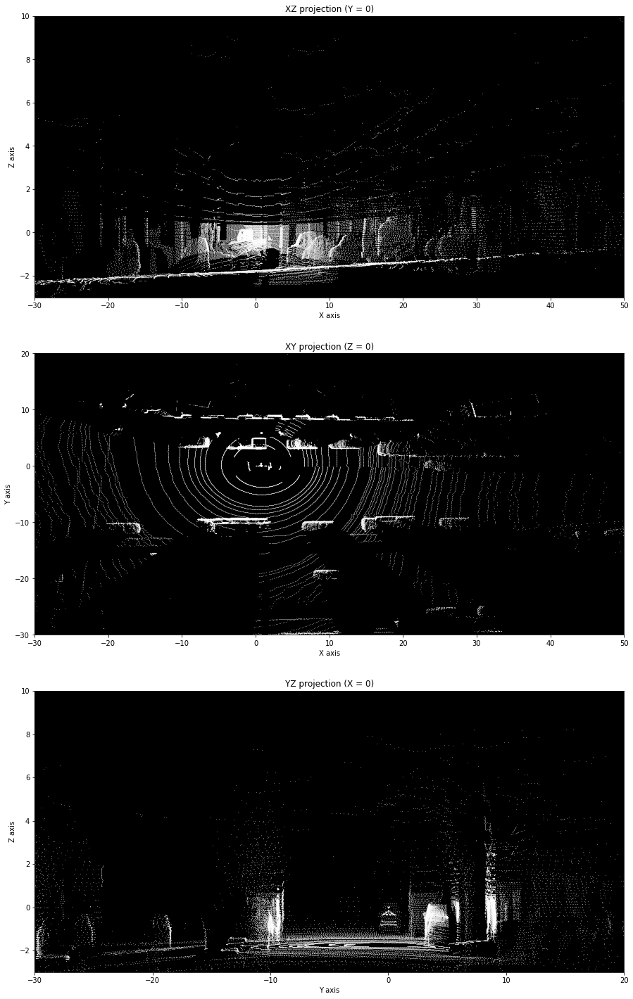

In [19]:
display_frame_statistics(pc.points, points=0.5)

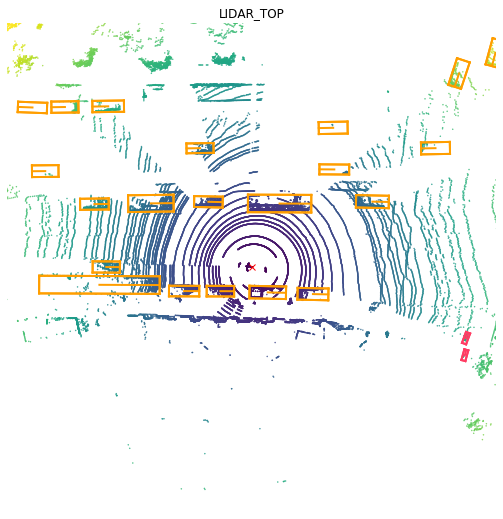

In [21]:
lyftdata.render_sample_data(lidar_top['token'], with_anns=True)